## Things to do CV Code

1. Install OpenCV on Raaspberry pi
2. Install X11 apps to send live feed to laptop  
    1. Use Xming X to see live feed

3. Install or create Database for tennis balls and cardboard boxes
4. Calibrate the camera to get Camera matrices
5. Create or modify existing model for Tennis ball detection
6. Get a Heatsink for Raspberry Pi



<table>
<thead>
<tr><th>Models</th><th>Estimated FPS on Raspberry Pi 4B</th><th>Notes</th><th>Accuracy (mAP)</th></tr>
</thead>
<tbody>
<tr>
<td>Custom Algorithm (e.g., color thresholding + blob detection)</td>
<td>10 FPS</td>
<td>
- Allows the model to be tailored to the robot's conditions<br>
- More time-consuming to create model from scratch<br>
- Can be very fast but may struggle with complex scenes or varying lighting conditions
</td>
<td>Varies (typically lower than ML models)</td>
</tr>
<tr>
<td>MobileNet-SSD v2</td>
<td>1-3 FPS</td>
<td>
- Good balance of speed and accuracy<br>
- Designed for mobile and embedded devices<br>
- Widely used and well-documented
</td>
<td>22.1% mAP (COCO dataset)</td>
</tr>
<tr>
<td>YOLOv5-nano</td>
<td>0.5-2 FPS</td>
<td>
- Very small model size (~1MB)<br>
- Good for detecting small objects<br>
- May require careful optimization for Raspberry Pi
</td>
<td>25.4% mAP (COCO dataset)</td>
</tr>
<tr>
<td>EfficientDet-Lite0</td>
<td>0.5-1.5 FPS</td>
<td>
- Balanced efficiency-accuracy trade-off<br>
- Part of the EfficientDet family, known for scalability<br>
- Good documentation and TensorFlow Lite support
</td>
<td>27.5% mAP (COCO dataset)</td>
</tr>
<tr>
<td>TinyYOLOv3</td>
<td>1-3 FPS</td>
<td>
- Designed for speed on embedded devices<br>
- Smaller and faster than full YOLOv3<br>
- May miss small objects more often than larger models
</td>
<td>33.1% mAP (COCO dataset)</td>
</tr>
<tr>
<td>MobileNetV2 + SSDLite</td>
<td>1-2 FPS</td>
<td>
- Optimized version of MobileNet-SSD<br>
- Very memory-efficient<br>
- Good for resource-constrained devices
</td>
<td>22% mAP (COCO dataset)</td>
</tr>
</tbody>
</table>

predefined models may be faster if we limit what its looking for, we could use this as a safety meaasure, incase custom model doesnt work
-   I.e. Work on developing a pre developed model such as MobileNet or YOLO through TensorLite, then work on Custom Model
- USe of Roboflow to create Datasets, or use Predefined datasets, limiting what its trained on

### Custom Algorithm
#### Colour Based Detection
1. Convert image to HSV colourspace
2. Define colour range of tennis balls
3. Create binary mask using the colour range of tennis ball
4. Apply morphological operations to clean the mask
5. Filter contours based on area and circularity

#### Edge Detection
1. Convert images to greyscale
2. Apply Gaussian Blur to reduce noise
3. Use Canny Edge detection
4. Apply Hough Circle transform
5. Filter circles based on size

#### Combination of methods
1. Use colour thereshold to create a region of interest
2. Apply Hough Transformation only on ROI
3. Verify using colour information

#### Ball Tracking (Kalman Filters)
1. Initialise Kalman Filter for each ball detected
2. Predict new positions in each frame
3. Update predictions with new detections

##### Tips to make it faster
- Implimenting multi-threadings to parallelize detection and robot control
-       reducing image resolution to improve processing speed
-


In [ ]:
import tensorflow as tf
import os




### 1. Installing Dependencies for google Colab

In [ ]:
# add all dependencies here for google colab and training

# the following section of code needs to be un when operating on google colab
!pip uninstall Cython -y
!git clone --depth 1 https://github.com/tensorflow/models

Found existing installation: Cython 3.0.11
Uninstalling Cython-3.0.11:
  Successfully uninstalled Cython-3.0.11
Cloning into 'models'...
remote: Enumerating objects: 4297, done.
remote: Counting objects: 100% (4297/4297), done.
remote: Compressing objects: 100% (3278/3278), done.
remote: Total 4297 (delta 1208), reused 2176 (delta 947), pack-reused 0 (from 0)
Receiving objects: 100% (4297/4297), 52.92 MiB | 14.46 MiB/s, done.
Resolving deltas: 100% (1208/1208), done.


In [ ]:
# copying setup files into model/research folder
%%bash
cd models/research
protoc object_detection/protos/*.proto --python_out=.
#cp object_detection/packages/tf2/setup.py .

In [ ]:
# Modify setup.py file to install the tf-models-official repository targeted at TF v2.8.0
import re
with open('/content/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

In [ ]:
# Install the Object Detection API (NOTE: This block takes about 10 minutes to finish executing)

# Need to do a temporary fix with PyYAML because Colab isn't able to install PyYAML v5.4.1
!pip install pyyaml==5.3
!pip install /content/models/research/

# Need to downgrade to TF v2.8.0 due to Colab compatibility bug with TF v2.10 (as of 10/03/22)
!pip install tensorflow==2.8.0

# Install CUDA version 11.0 (to maintain compatibility with TF v2.8.0)
!pip install tensorflow_io==0.23.1
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
!mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!dpkg -i cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!apt-key add /var/cuda-repo-ubuntu1804-11-0-local/7fa2af80.pub
!apt-get update && sudo apt-get install cuda-toolkit-11-0
!export LD_LIBRARY_PATH=/usr/local/cuda-11.0/lib64:$LD_LIBRARY_PATH

Processing ./models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object_detection: filename=object_detection-0.1-py3-none-any.whl size=1697356 sha256=fb37519793a13190a92d9a35a0faf9144eae213da3771589cbe03628058e00aa
  Stored in directory: /tmp/pip-ephem-wheel-cache-q8fpqszj/wheels/53/dd/70/2de274d6c443c69d367bd6a5606f95e5a6df61aacf1435ec0d
Successfully built object_detection
  Attempting uninstall: object_detection
    Found existing installation: object_detection 0.1
    Uninstalling object_detection-0.1:
      Successfully uninstalled object_detection-0.1
  Using cached tensorflow-2.8.0-cp310-cp310-manylinux2010_x86_64.whl.metadata (2.9 kB)
  Using cached tf_estimator_nightly-2.8.0.dev2021122109-py2.py3-none-any.whl.metadata (1.2 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 497.6/497.6 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.5/462.5 kB 33.8 MB/s eta 0:00:00
  Attempting uninstall: tensorflow
    Found existing installation: t

In [40]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# verifying the model by running Model Builder
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py


Running tests under Python 3.10.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2024-08-22 20:29:11.069762: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0822 20:29:11.511260 133422276174464 model_builder.py:1112] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 1.43s
I0822 20:29:11.789546 133422276174464 test_util.py:2373] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 1.43s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.57s
I0822 20:29:12.358618 133422276174464 tes

### 2. Dataset manipulation, getting it ready for training

Run the below code for Google Colab

In [41]:
from google.colab import drive
drive.mount('/content/gdrive')
!cp -r /content/gdrive/MyDrive/CV/images/ /content/images/

train_record_fname = '/content/images/train/cardboard-tennis.tfrecord'
val_record_fname = '/content/images/valid/cardboard-tennis.tfrecord'
label_map_pbtxt_fname = '/content/images/train/cardboard-tennis_label_map.pbtxt'

Mounted at /content/gdrive


### 3. Setup Training Configuration

In [ ]:
# Change the chosen_model variable to deploy different models available in the TF2 object detection zoo
chosen_model = 'ssd-mobilenet-v2-fpnlite-320'

MODELS_CONFIG = {
    'ssd-mobilenet-v2': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
    },
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
    },
    'ssd-mobilenet-v2-fpnlite-320': {
        'model_name': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz',
    },
    # The centernet model isn't working as of 9/10/22
    #'centernet-mobilenet-v2': {
    #    'model_name': 'centernet_mobilenetv2fpn_512x512_coco17_od',
    #    'base_pipeline_file': 'pipeline.config',
    #    'pretrained_checkpoint': 'centernet_mobilenetv2fpn_512x512_coco17_od.tar.gz',
    #}
}

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']

In [ ]:
!mkdir -p /content/model/my_model
%cd /content/model/my_model

#downloading the pretrained model
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint
!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

# Download training configuration file for model
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}



/content/model/my_model
--2024-08-22 20:30:11--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.200.207, 74.125.130.207, 74.125.68.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.200.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  9.66MB/s    in 2.0s    

2024-08-22 20:30:13 (9.66 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

--2024-08-22 20:30:14--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.19

In [ ]:
# setting up training params for the model
num_steps = 40000
if chosen_model == 'efficientdet-d0':
    batch_size = 4
else:
    batch_size = 16

In [ ]:
print(base_pipeline_file)
pipeline_fname = '/content/model/my_model/' + base_pipeline_file
print(pipeline_fname)
print('/content/model/my_model/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config')
fine_tune_checkpoint = '/content/model/my_model/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print('Total classes:', num_classes)


ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
/content/model/my_model/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
/content/model/my_model/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
Total classes: 3


In [ ]:
# Create custom configuration file by writing the dataset, model checkpoint, and training parameters into the base pipeline file
import re

%cd /content/model/mymodel
print('writing custom configuration file')

with open(pipeline_fname) as f:   ## originally the input to the function was pipeline_fname
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # Set fine_tune_checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    # Set tfrecord files for train and test datasets
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(val_record_fname), s)

    # Set label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set batch_size
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    # Change fine-tune checkpoint type from "classification" to "detection"
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    # If using ssd-mobilenet-v2, reduce learning rate (because it's too high in the default config file)
    if chosen_model == 'ssd-mobilenet-v2':
      s = re.sub('learning_rate_base: .8',
                 'learning_rate_base: .08', s)

      s = re.sub('warmup_learning_rate: 0.13333',
                 'warmup_learning_rate: .026666', s)

    # If using efficientdet-d0, use fixed_shape_resizer instead of keep_aspect_ratio_resizer (because it isn't supported by TFLite)
    if chosen_model == 'efficientdet-d0':
      s = re.sub('keep_aspect_ratio_resizer', 'fixed_shape_resizer', s)
      s = re.sub('pad_to_max_dimension: true', '', s)
      s = re.sub('min_dimension', 'height', s)
      s = re.sub('max_dimension', 'width', s)

    f.write(s)


[Errno 2] No such file or directory: '/content/model/mymodel'
/content/model/my_model
writing custom configuration file


In [ ]:
# Set the path to the custom config file and the directory to store training checkpoints in
pipeline_file = '/content/model/my_model/pipeline_file.config'
model_dir = '/content/training'

### 4. Training the data

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

In [ ]:
# Run training!
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.13.0 and strictly below 2.16.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're us

### 5. Converting model o TensorFlow Lite ans saving it

In [ ]:
# Make a directory to store the trained TFLite model
!mkdir /content/custom_model_lite
output_directory = '/content/custom_model_lite'

# Path to training directory (the conversion script automatically chooses the highest checkpoint file)
last_model_path = '/content/training'

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}


2024-08-22 23:09:00.258170: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
I0822 23:09:03.938585 140637612847744 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
I0822 23:09:08.970931 140637612847744 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
2024-08-22 23:09:10.720821: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.
I0822 23:09:11.332725 140637612847744 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
W0822 23:09:12.587286 140637612847744 save_impl.py:71] Skipping full serialization of Keras layer <object_detection.meta_architectures.ssd_meta_arch.SSDMetaArch object at 0x7fe803f4c730>, because it is not built.
W0822 23:09:12.823844

In [ ]:
# Convert exported graph file into TFLite model file
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/content/custom_model_lite/saved_model')
tflite_model = converter.convert()

with open('/content/custom_model_lite/detect.tflite', 'wb') as f:
  f.write(tflite_model)

### Testing the Model

In [ ]:
# Script to run custom TFLite model on test images to detect objects
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  # Grab filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])


      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

In [ ]:
### This creates a a "labelmap.txt" file with a list of classes the object detection model will detect.
%%bash
cat <<EOF >> /content/labelmap.txt
Cardboard
ball
cardboard
EOF

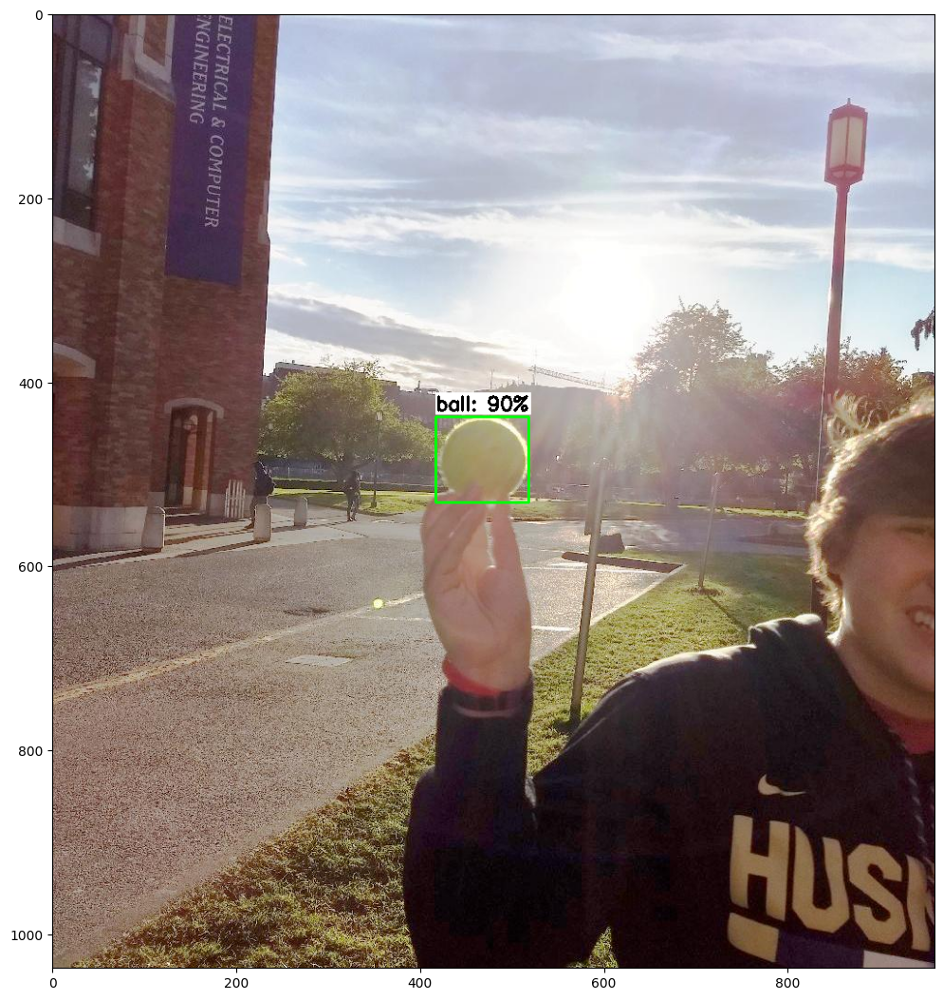

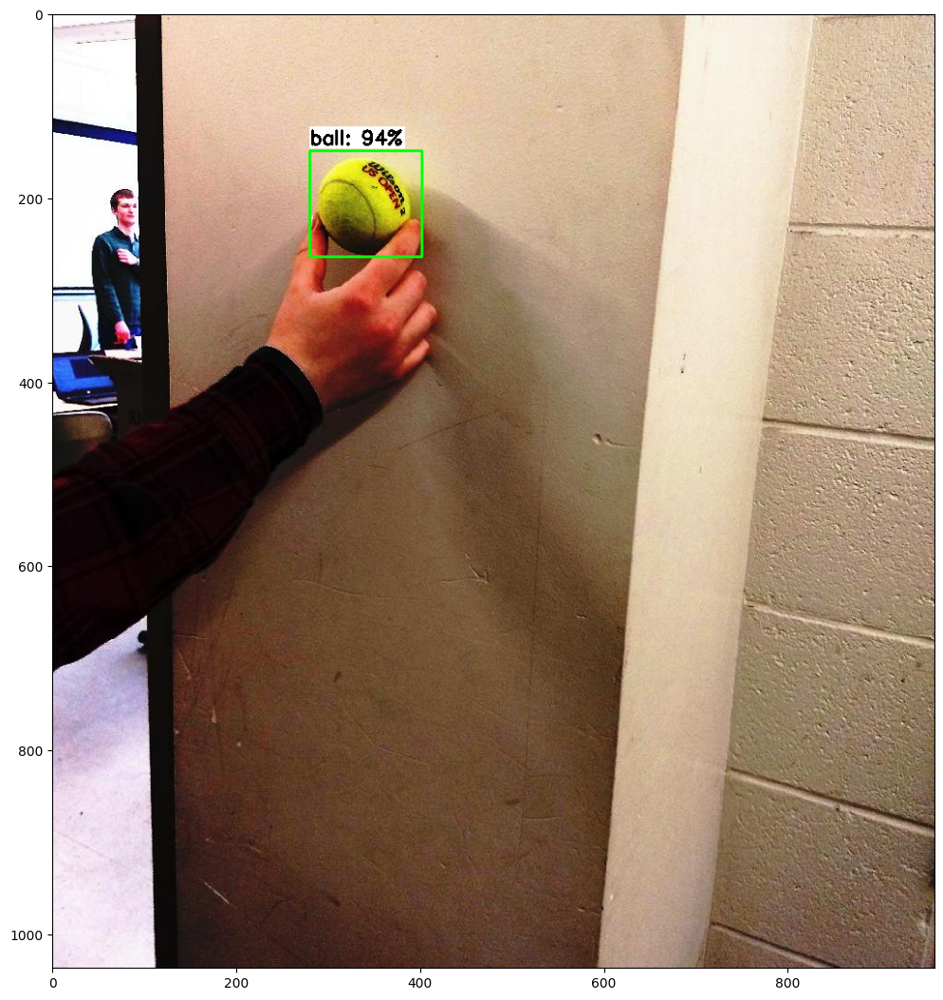

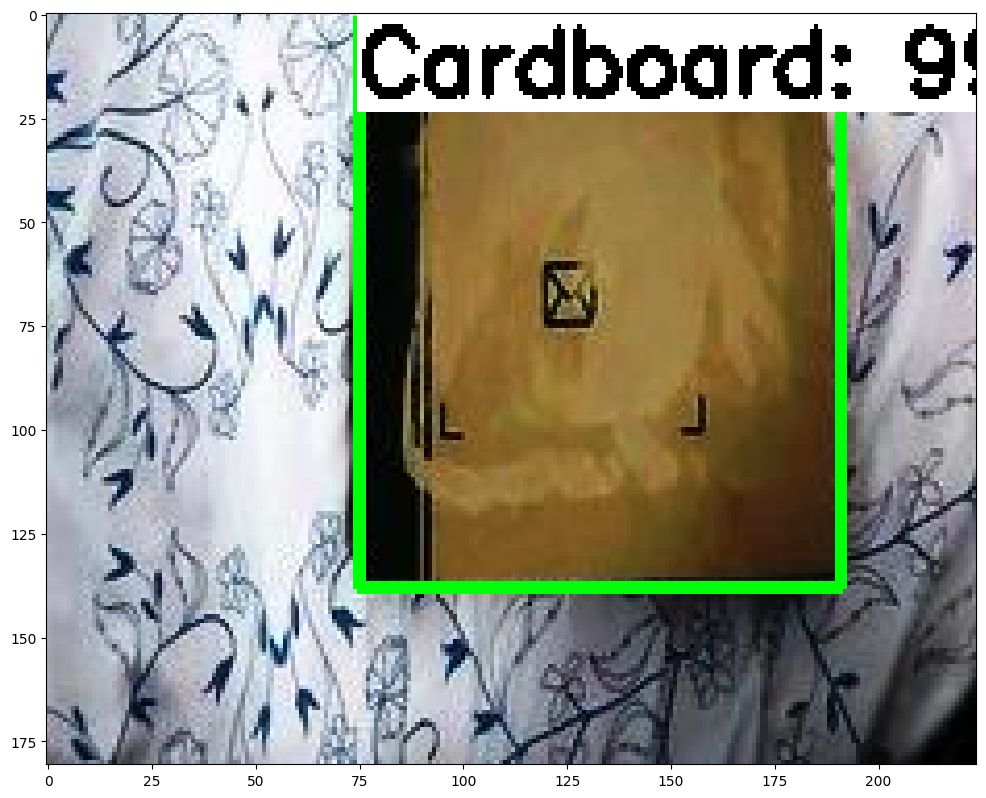

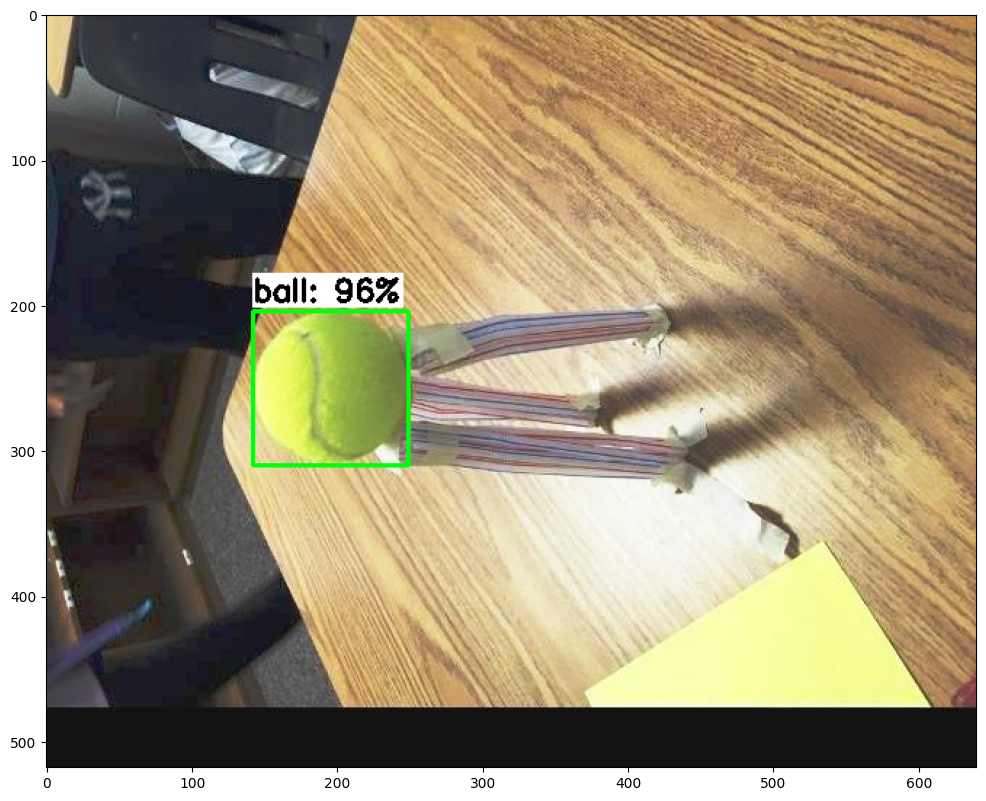

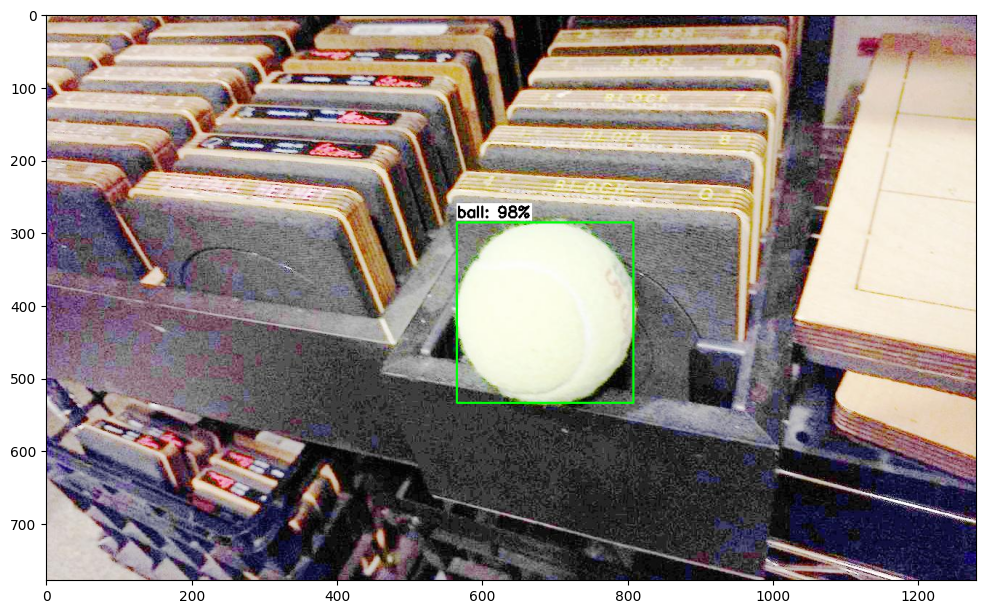

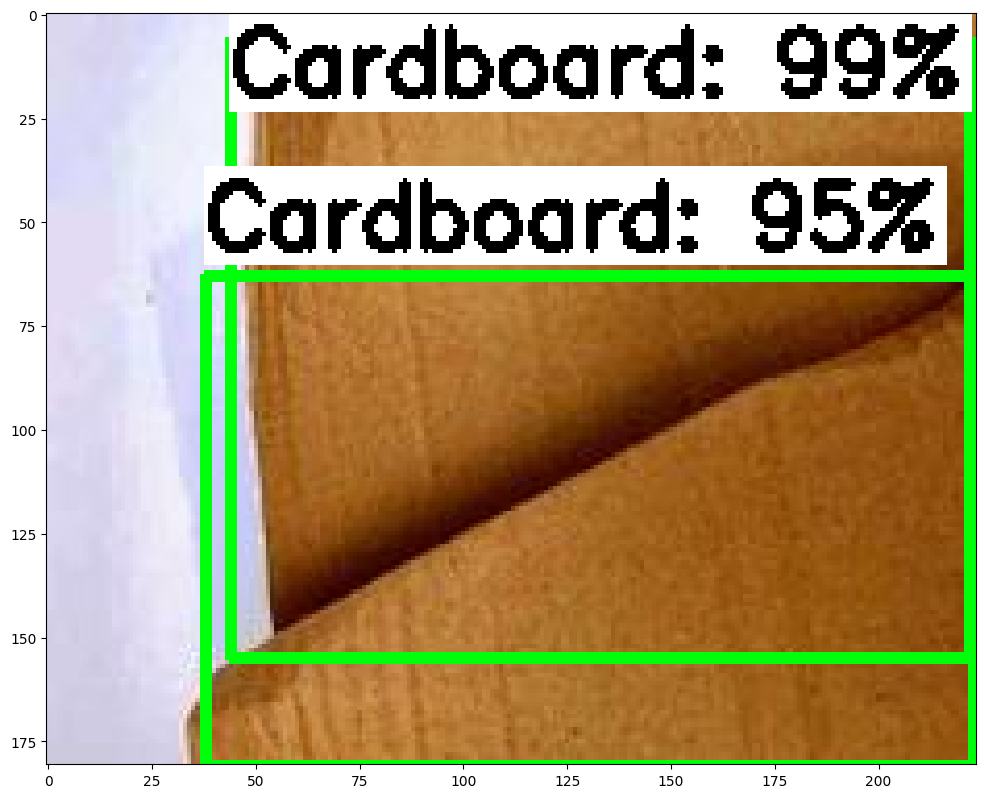

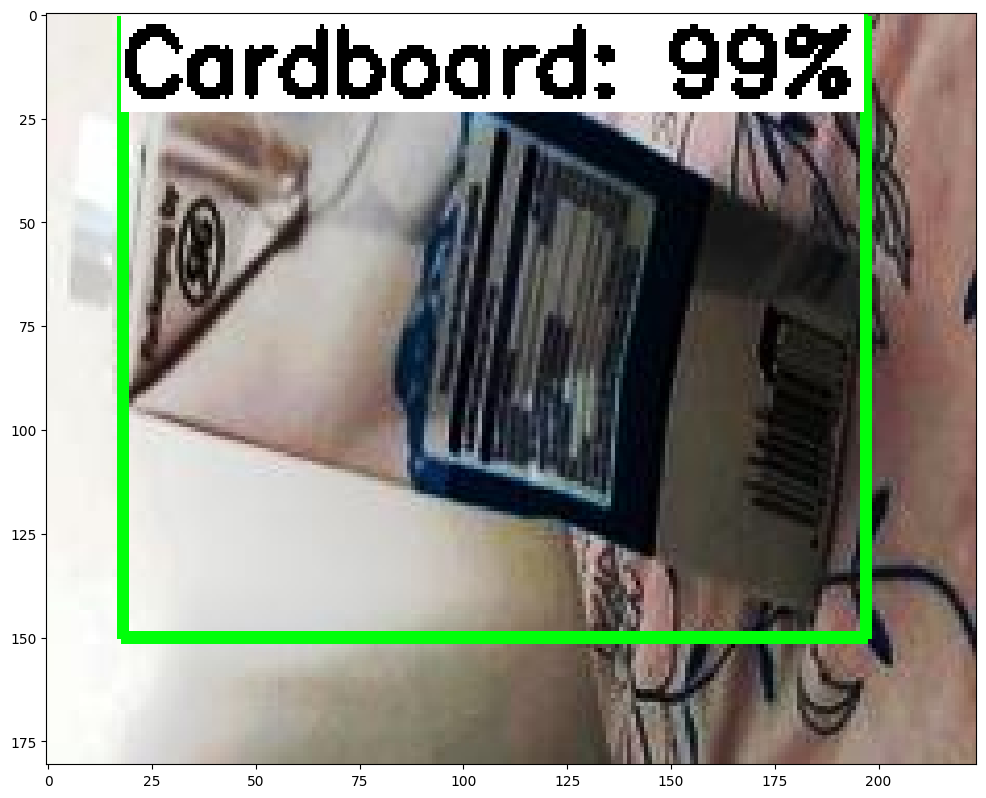

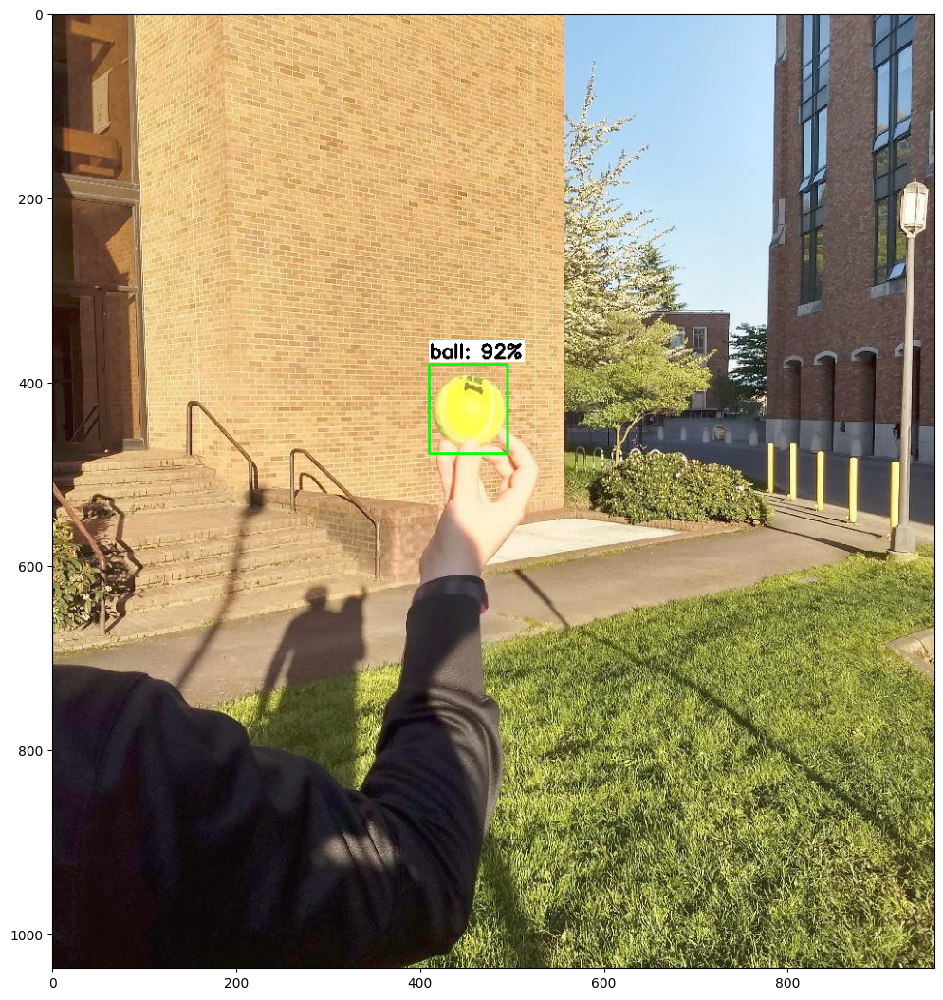

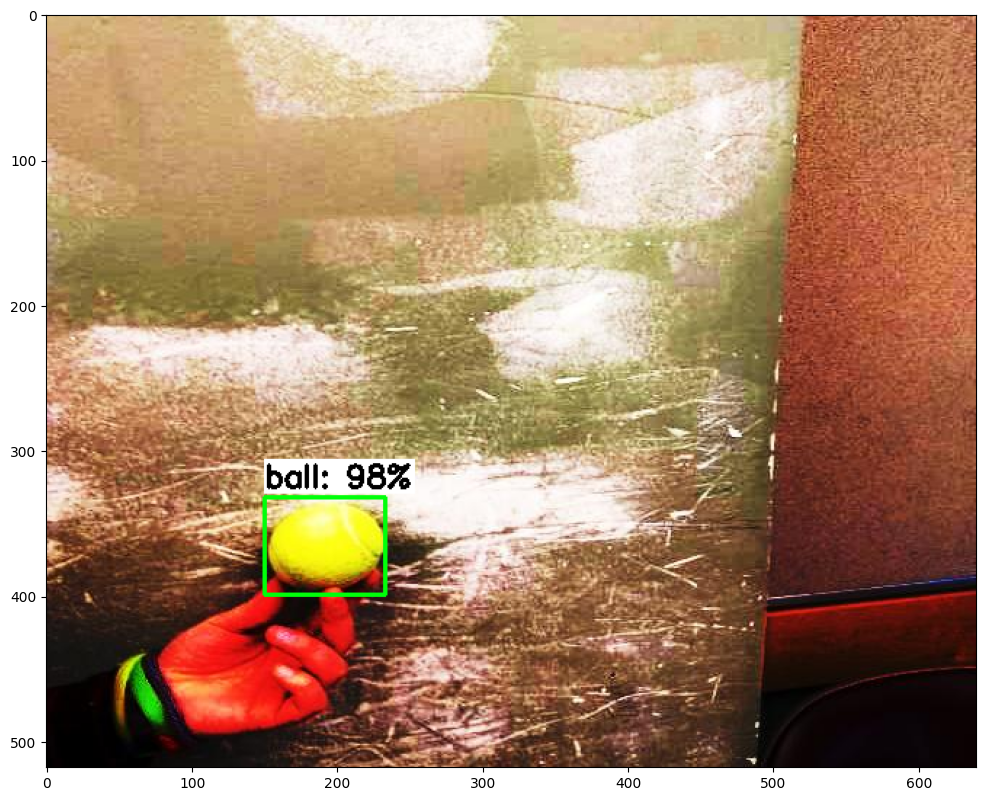

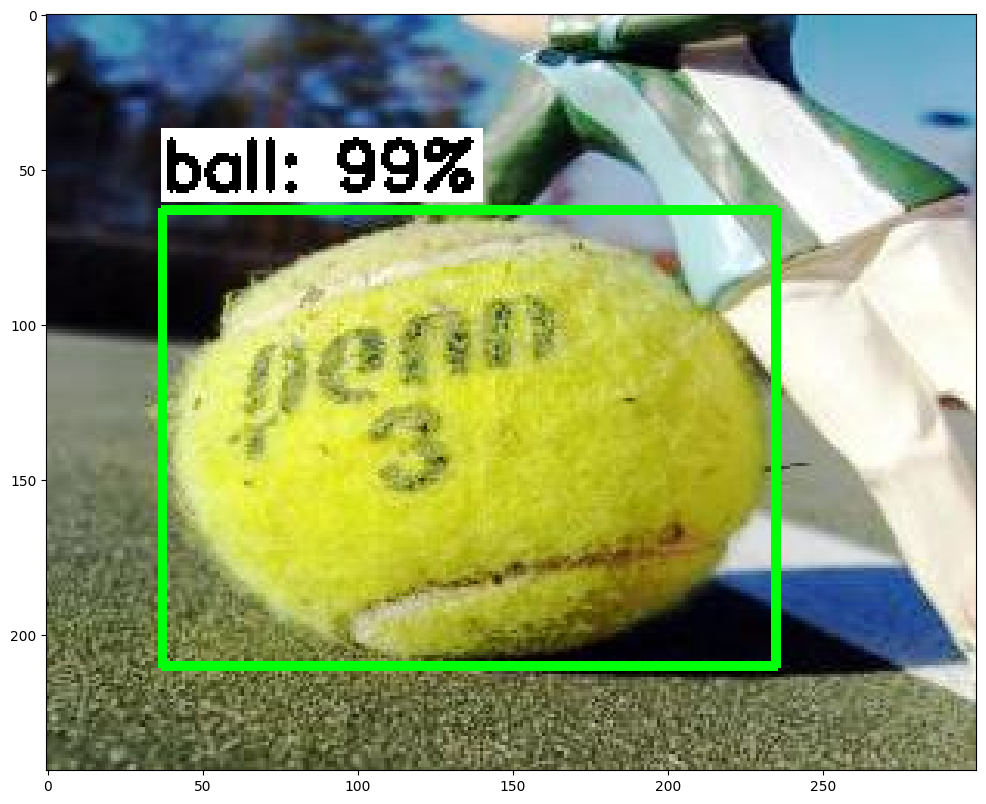

In [ ]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/images/test/test'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/labelmap.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 10   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

### Calculating mAP

In [ ]:
%%bash
git clone https://github.com/Cartucho/mAP /content/mAP
cd /content/mAP
rm input/detection-results/*
rm input/ground-truth/*
rm input/images-optional/*
wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

Cloning into '/content/mAP'...
--2024-08-22 23:09:59--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py’

     0K .....                                                 100% 73.9M=0s

2024-08-22 23:09:59 (73.9 MB/s) - ‘calculate_map_cartucho.py’ saved [5397/5397]



In [42]:
!cp /content/images/test/test/* /content/mAP/input/images-optional
!mv /content/gdrive/MyDrive/CV/images/test/test_xml/*.xml /content/mAP/input/ground-truth/

In [43]:
!python /content/mAP/scripts/extra/convert_gt_xml.py

Conversion completed!


In [44]:
# Set up variables for running inference, this time to get detection results saved as .txt files
PATH_TO_IMAGES='/content/images/test/test'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/labelmap.txt'   # Path to labelmap.txt file
PATH_TO_RESULTS='/content/mAP/input/detection-results' # Folder to save detection results in
min_conf_threshold=0.1   # Confidence threshold

# Use all the images in the test folder
image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(500, len(image_list)) # If there are more than 500 images in the folder, just use 500

# Tell function to just save results and not display images
txt_only = True

# Run inferencing function!
print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 215 images...
Finished inferencing!


In [45]:
%cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/labelmap.txt

/content/mAP
Calculating mAP at 0.50 IoU threshold...
99.91% = Cardboard AP 
84.68% = ball AP 
mAP = 92.30%
Calculating mAP at 0.55 IoU threshold...
99.91% = Cardboard AP 
81.74% = ball AP 
mAP = 90.82%
Calculating mAP at 0.60 IoU threshold...
98.07% = Cardboard AP 
80.28% = ball AP 
mAP = 89.18%
Calculating mAP at 0.65 IoU threshold...
98.07% = Cardboard AP 
77.06% = ball AP 
mAP = 87.57%
Calculating mAP at 0.70 IoU threshold...
98.07% = Cardboard AP 
74.55% = ball AP 
mAP = 86.31%
Calculating mAP at 0.75 IoU threshold...
98.07% = Cardboard AP 
68.77% = ball AP 
mAP = 83.42%
Calculating mAP at 0.80 IoU threshold...
98.07% = Cardboard AP 
54.27% = ball AP 
mAP = 76.17%
Calculating mAP at 0.85 IoU threshold...
96.62% = Cardboard AP 
39.86% = ball AP 
mAP = 68.24%
Calculating mAP at 0.90 IoU threshold...
79.35% = Cardboard AP 
18.32% = ball AP 
mAP = 48.84%
Calculating mAP at 0.95 IoU threshold...
45.66% = Cardboard AP 
2.47% = ball AP 
mAP = 24.06%

***mAP Results***

Class		Average mAP

### Download the TFLite Model


In [ ]:
# Move labelmap and pipeline config files into TFLite model folder and zip it up
!cp /content/labelmap.txt /content/custom_model_lite
!cp /content/images/train/cardboard-tennis_label_map.pbtxt /content/custom_model_lite
!cp /content/model/my_model/pipeline_file.config /content/custom_model_lite

%cd /content
!zip -r custom_model_lite.zip custom_model_lite

/content
updating: custom_model_lite/ (stored 0%)
updating: custom_model_lite/labelmap.txt (deflated 28%)
updating: custom_model_lite/detect.tflite (deflated 9%)
updating: custom_model_lite/saved_model/ (stored 0%)
updating: custom_model_lite/saved_model/saved_model.pb (deflated 91%)
updating: custom_model_lite/saved_model/assets/ (stored 0%)
updating: custom_model_lite/saved_model/variables/ (stored 0%)
updating: custom_model_lite/saved_model/variables/variables.index (deflated 78%)
updating: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 9%)
  adding: custom_model_lite/pipeline_file.config (deflated 66%)
  adding: custom_model_lite/cardboard-tennis_label_map.pbtxt (deflated 63%)


In [ ]:
from google.colab import files

files.download('/content/custom_model_lite.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [46]:
%cd /content
!zip -r training.zip training

/content
  adding: training/ (stored 0%)
  adding: training/ckpt-35.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-38.index (deflated 82%)
  adding: training/ckpt-38.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-37.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-40.index (deflated 82%)
  adding: training/ckpt-40.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-37.index (deflated 82%)
  adding: training/ckpt-39.index (deflated 82%)
  adding: training/train/ (stored 0%)
  adding: training/train/events.out.tfevents.1724358639.a667f02b4594.7914.0.v2 (deflated 0%)
  adding: training/ckpt-41.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-41.index (deflated 82%)
  adding: training/ckpt-36.index (deflated 82%)
  adding: training/ckpt-39.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-35.index (deflated 82%)
  adding: training/ckpt-36.data-00000-of-00001 (deflated 7%)
  adding: training/checkpoint (deflated 76%)


In [47]:
files.download('/content/training.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 7. Deployment of Model

In [ ]:
# Load the saved model and use it to detect in this bit

### 7. Quantasize the model (maybe)